# Importing the Libraries

In [1]:
import csv
import os
import pandas as pd
import numpy as np
import glob
import warnings
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from pandas import Series, DataFrame
warnings.filterwarnings("ignore")

# Loading the data files and merging it into one

In [5]:
files=os.listdir()
line_count=0

In [6]:
for file in files:
    if file.endswith('.csv'):
        with open(file,'r') as f1:
            csv_reader=csv.reader(f1,delimiter=',')
            with open('Combined.csv','a',newline='') as f2:
                csv_writer=csv.writer(f2,delimiter=',')
                if line_count==0:
                    csv_writer.writerow(["Company","Date","Open","High","Low","Close","Adj","Volume"])
                    line_count+=1

                next(csv_reader,None)
                for row in csv_reader:
                    data=[file[:-4]] +row
                    csv_writer.writerow(data)
    

In [2]:
data=pd.read_csv("Combined.csv")

Keeping only the important columns

In [3]:
imp_data=data[['Company', "Date", "Close", "Volume"]]

In [4]:
imp_data.reset_index(drop=True,inplace=True)

In [5]:
imp_data

,Company,Date,Close,Volume
0,AAL,01-10-2010,9.290000,3603800.0
1,AAL,04-10-2010,9.120000,3856800.0
2,AAL,05-10-2010,9.230000,3896600.0
3,AAL,06-10-2010,9.230000,3230200.0
4,AAL,07-10-2010,9.240000,3877700.0
...,...,...,...,...
63790,WFC,24-09-2020,23.320000,43329100.0
63791,WFC,25-09-2020,23.639999,30229900.0
63792,WFC,28-09-2020,23.820000,41103500.0
63793,WFC,29-09-2020,23.260000,38416300.0


In [6]:
imp_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63795 entries, 0 to 63794
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Company  63795 non-null  object 
 1   Date     63642 non-null  object 
 2   Close    63642 non-null  float64
 3   Volume   63642 non-null  float64
dtypes: float64(2), object(2)
memory usage: 1.9+ MB


Converting to Date type for further analysis

In [7]:
imp_data['Date']=pd.to_datetime(imp_data['Date'])

In [9]:
imp_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63795 entries, 0 to 63794
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Company  63795 non-null  object        
 1   Date     63642 non-null  datetime64[ns]
 2   Close    63642 non-null  float64       
 3   Volume   63642 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 1.9+ MB


In [8]:
imp_data.head()

,Company,Date,Close,Volume
0,AAL,2010-01-10,9.29,3603800.0
1,AAL,2010-04-10,9.12,3856800.0
2,AAL,2010-05-10,9.23,3896600.0
3,AAL,2010-06-10,9.23,3230200.0
4,AAL,2010-07-10,9.24,3877700.0


In [11]:
imp_data.set_index('Date')

,Company,Close,Volume
Date,,,
2010-01-10,AAL,9.290000,3603800.0
2010-04-10,AAL,9.120000,3856800.0
2010-05-10,AAL,9.230000,3896600.0
2010-06-10,AAL,9.230000,3230200.0
2010-07-10,AAL,9.240000,3877700.0
...,...,...,...
2020-09-24,WFC,23.320000,43329100.0
2020-09-25,WFC,23.639999,30229900.0
2020-09-28,WFC,23.820000,41103500.0


In [11]:
imp_data.to_csv("Final_Data.csv")

Processed dataset which contains the columns having the closing price of the stocks is loaded


The dates taken for each stock is from 2015 to 2020 for further analysis

# Analysis is done for the time period 2015-2020

In [13]:
proc_data=pd.read_csv("Vignesh_J_Nathan_Final_Dataset.csv")

In [14]:
proc_data.head()

,Date,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
0,2/1/2015,53.910000,27.332500,149.860001,60.330002,308.519989,14.92,144.449997,24.990000,49.180000,...,104.519997,42.689999,57.189999,37.500000,46.759998,31.33,34.279999,100.779999,54.700001,2058.199951
1,5/1/2015,53.880001,26.562500,148.630005,59.470001,302.190002,14.31,144.289993,24.240000,48.360001,...,103.790001,41.639999,58.040001,36.419998,46.330002,31.16,34.450001,99.120003,53.200001,2020.579956
2,6/1/2015,53.040001,26.565001,147.839996,58.770000,295.290009,14.00,142.830002,23.809999,47.220001,...,103.279999,40.459999,60.320000,36.939999,45.650002,31.42,34.660000,98.919998,52.090000,2002.609985
3,7/1/2015,53.009998,26.937500,149.979996,59.669998,298.420013,14.04,145.119995,23.790001,46.970001,...,105.559998,40.799999,61.610001,37.490002,46.230000,31.85,34.810001,99.930000,52.400002,2025.900024
4,8/1/2015,53.660000,27.972500,155.289993,60.700001,300.459991,14.28,154.100006,23.610001,48.189999,...,106.389999,41.880001,62.849998,36.880001,47.590000,32.50,35.189999,104.699997,53.560001,2062.139893


In [15]:
proc_data.set_index('Date')

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
Date,,,,,,,,,,,,,,,,,,,,,
2/1/2015,53.910000,27.332500,149.860001,60.330002,308.519989,14.92,144.449997,24.990000,49.180000,30.469999,...,104.519997,42.689999,57.189999,37.500000,46.759998,31.330000,34.279999,100.779999,54.700001,2058.199951
5/1/2015,53.880001,26.562500,148.630005,59.470001,302.190002,14.31,144.289993,24.240000,48.360001,28.820000,...,103.790001,41.639999,58.040001,36.419998,46.330002,31.160000,34.450001,99.120003,53.200001,2020.579956
6/1/2015,53.040001,26.565001,147.839996,58.770000,295.290009,14.00,142.830002,23.809999,47.220001,28.360001,...,103.279999,40.459999,60.320000,36.939999,45.650002,31.420000,34.660000,98.919998,52.090000,2002.609985
7/1/2015,53.009998,26.937500,149.979996,59.669998,298.420013,14.04,145.119995,23.790001,46.970001,28.660000,...,105.559998,40.799999,61.610001,37.490002,46.230000,31.850000,34.810001,99.930000,52.400002,2025.900024
8/1/2015,53.660000,27.972500,155.289993,60.700001,300.459991,14.28,154.100006,23.610001,48.189999,28.719999,...,106.389999,41.880001,62.849998,36.880001,47.590000,32.500000,35.189999,104.699997,53.560001,2062.139893
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/24/2020,11.770000,108.220001,121.500000,35.700001,3019.790039,4.75,15.220000,9.620000,29.010000,8.110000,...,144.669998,36.860001,83.150002,47.040001,203.190002,35.759998,42.810001,292.660004,23.320000,3246.590088
9/25/2020,12.290000,112.279999,123.760002,36.700001,3095.129883,4.70,15.300000,9.480000,29.780001,8.000000,...,145.660004,37.099998,82.930000,48.380001,207.820007,36.049999,44.820000,302.500000,23.639999,3298.459961
9/28/2020,12.760000,114.959999,127.110001,37.540001,3174.050049,4.99,15.270000,9.900000,31.340000,8.430000,...,147.110001,38.240002,82.760002,47.240002,209.440002,36.389999,44.110001,303.230011,23.820000,3351.600098


In [16]:
proc_data.describe()

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
count,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.00000,1447.000000,1447.000000,1447.000000,1447.000000,...,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000,1447.000000
mean,37.607021,44.925840,149.983020,67.065529,1296.977208,10.17141,51.691852,15.691866,47.800083,15.933407,...,125.209696,48.263822,66.713400,41.898307,94.716787,35.978701,33.727733,200.560705,49.804278,2537.701720
std,11.304062,20.370899,28.053088,14.517988,708.902761,3.03238,66.816726,5.104257,8.851645,7.870094,...,16.196307,8.966166,11.346465,8.352676,46.861798,3.673225,4.438954,64.301461,8.806183,411.747358
min,9.040000,22.584999,66.230003,23.559999,286.950012,3.84000,8.510000,6.670000,19.190001,5.480000,...,90.730003,23.870001,48.419998,21.690001,40.290001,28.490000,26.389999,98.919998,22.530001,1829.079956
25%,31.650000,29.560001,133.254998,62.160000,715.609985,8.38000,17.304999,12.235000,44.344999,9.130000,...,113.285000,40.820000,57.750000,36.164999,55.129999,33.435000,30.884999,134.639999,47.840000,2114.625000
50%,39.669998,39.970001,148.000000,66.160004,1129.170044,9.83000,23.059999,14.540000,49.360001,14.620000,...,128.740005,50.490002,62.889999,42.889999,83.339996,35.230000,32.509998,211.220001,52.220001,2549.689941
75%,46.269998,51.690000,168.074997,75.175003,1794.965027,11.37000,29.285000,16.730000,54.144998,19.010000,...,138.430000,54.959999,77.614998,48.269998,123.720001,37.655001,35.295000,253.714996,55.045000,2857.015014
max,58.470001,134.179993,233.979996,100.239998,3531.449951,17.98000,262.519989,29.690001,63.160000,36.060001,...,155.509995,66.290001,92.040001,58.910000,231.649994,46.230000,46.840000,323.700012,65.930000,3580.840088


In [17]:
proc_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1447 entries, 0 to 1446
Data columns (total 26 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    1447 non-null   object 
 1   AAL     1447 non-null   float64
 2   AAPL    1447 non-null   float64
 3   ALGT    1447 non-null   float64
 4   ALK     1447 non-null   float64
 5   AMZN    1447 non-null   float64
 6   BCS     1447 non-null   float64
 7   BHC     1447 non-null   float64
 8   CS      1447 non-null   float64
 9   DAL     1447 non-null   float64
 10  DB      1447 non-null   float64
 11  FB      1447 non-null   float64
 12  GOOG    1447 non-null   float64
 13  GS      1447 non-null   float64
 14  HA      1447 non-null   float64
 15  IBM     1447 non-null   float64
 16  JNJ     1447 non-null   float64
 17  LUV     1447 non-null   float64
 18  MRK     1447 non-null   float64
 19  MS      1447 non-null   float64
 20  MSFT    1447 non-null   float64
 21  PFE     1447 non-null   float64
 22  

In [18]:
proc_data['Date']=pd.to_datetime(proc_data['Date'])

In [19]:
proc_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1447 entries, 0 to 1446
Data columns (total 26 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    1447 non-null   datetime64[ns]
 1   AAL     1447 non-null   float64       
 2   AAPL    1447 non-null   float64       
 3   ALGT    1447 non-null   float64       
 4   ALK     1447 non-null   float64       
 5   AMZN    1447 non-null   float64       
 6   BCS     1447 non-null   float64       
 7   BHC     1447 non-null   float64       
 8   CS      1447 non-null   float64       
 9   DAL     1447 non-null   float64       
 10  DB      1447 non-null   float64       
 11  FB      1447 non-null   float64       
 12  GOOG    1447 non-null   float64       
 13  GS      1447 non-null   float64       
 14  HA      1447 non-null   float64       
 15  IBM     1447 non-null   float64       
 16  JNJ     1447 non-null   float64       
 17  LUV     1447 non-null   float64       
 18  MRK     

It could be concluded from the std that most fluctuating 5 stocks in the last 5years are : AMZN, BHC,WFC,ALGT

# 1.Visulaising the movement in price

NameError: name 'figure' is not defined

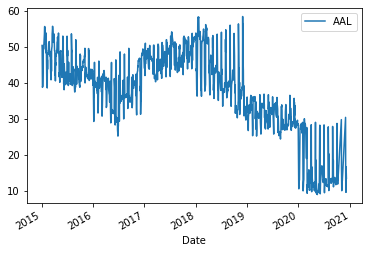

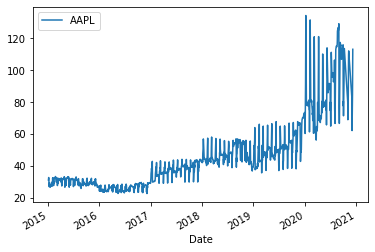

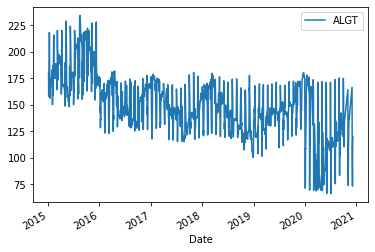

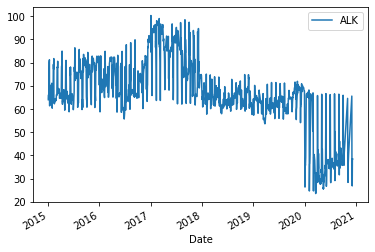

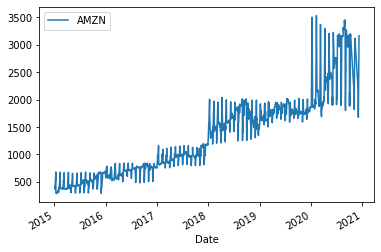

...

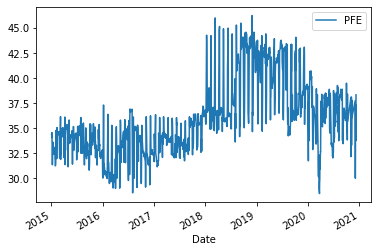

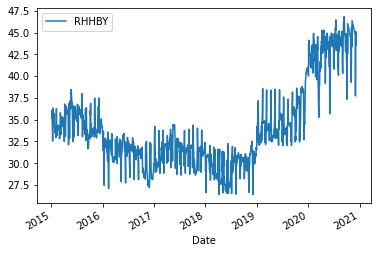

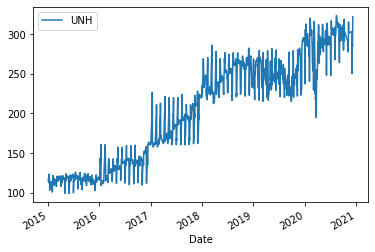

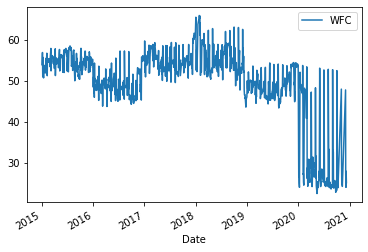

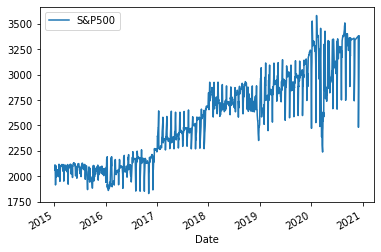

In [85]:
for col in proc_data.columns:
    if not col=="Date":
        proc_data.plot.line(x='Date',y=col)
plt.legend()
plt.show()

In [54]:
proc_data.corr()

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
AAL,1.000000,-0.723423,0.545133,0.756112,-0.725171,0.721758,0.270631,0.612120,0.523259,0.630119,...,-0.466988,0.480733,-0.691201,0.024895,-0.785741,-0.269526,-0.740385,-0.574980,0.861833,-0.551917
AAPL,-0.723423,1.000000,-0.453923,-0.665404,0.920607,-0.604210,-0.344153,-0.482922,-0.249209,-0.576500,...,0.729406,-0.056297,0.741981,0.566244,0.949540,0.381059,0.734137,0.835449,-0.681929,0.877263
ALGT,0.545133,-0.453923,1.000000,0.590245,-0.592911,0.780303,0.606185,0.748291,0.371677,0.677642,...,-0.663816,0.071081,-0.459538,-0.167547,-0.543980,-0.355583,-0.239209,-0.581367,0.587491,-0.454125
ALK,0.756112,-0.665404,0.590245,1.000000,-0.678326,0.537263,0.102483,0.376624,0.533254,0.440467,...,-0.428479,0.474506,-0.468386,-0.122058,-0.691277,-0.310176,-0.604153,-0.555005,0.762814,-0.506226
AMZN,-0.725171,0.920607,-0.592911,-0.678326,1.000000,-0.748165,-0.539679,-0.654110,-0.129818,-0.778705,...,0.827307,0.065808,0.776936,0.589385,0.966148,0.563736,0.541094,0.937901,-0.647026,0.928497
BCS,0.721758,-0.604210,0.780303,0.537263,-0.748165,1.000000,0.796894,0.957427,0.232507,0.917846,...,-0.759547,0.002337,-0.656404,-0.159721,-0.739477,-0.349588,-0.333951,-0.701743,0.690114,-0.637923
BHC,0.270631,-0.344153,0.606185,0.102483,-0.539679,0.796894,1.000000,0.875650,-0.104042,0.828236,...,-0.736550,-0.431604,-0.398451,-0.366667,-0.475154,-0.274157,0.098971,-0.597550,0.253159,-0.539245
CS,0.612120,-0.482922,0.748291,0.376624,-0.654110,0.957427,0.875650,1.000000,0.138420,0.929039,...,-0.739115,-0.108203,-0.610903,-0.161527,-0.636486,-0.328852,-0.189292,-0.651071,0.568008,-0.575822
DAL,0.523259,-0.249209,0.371677,0.533254,-0.129818,0.232507,-0.104042,0.138420,1.000000,-0.049223,...,0.062926,0.817995,0.058900,0.354654,-0.158843,0.339387,-0.490476,0.078618,0.713809,0.142333
DB,0.630119,-0.576500,0.677642,0.440467,-0.778705,0.917846,0.828236,0.929039,-0.049223,1.000000,...,-0.803204,-0.213278,-0.725586,-0.344367,-0.749671,-0.521646,-0.196930,-0.804327,0.487407,-0.745132


<AxesSubplot:>

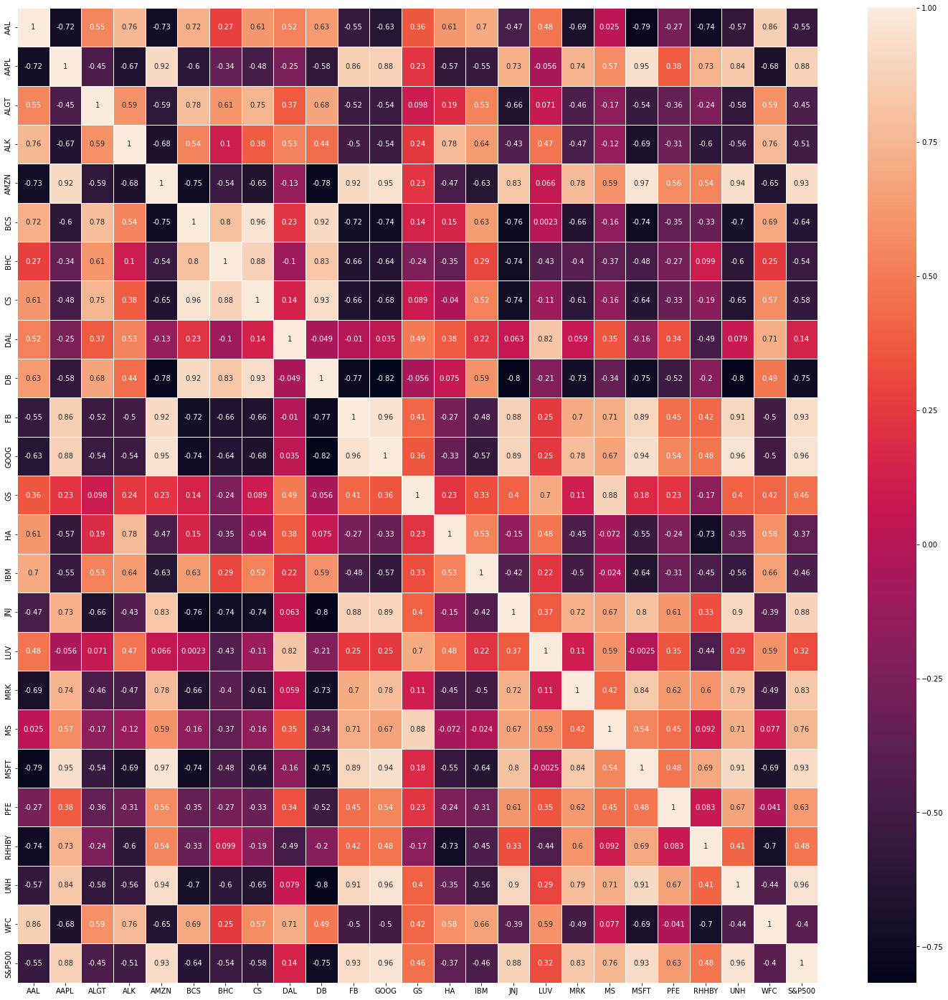

In [17]:
fig, ax = plt.subplots(figsize=(25,25))  
sns.heatmap(proc_data.corr(),annot=True,linewidth=.5,ax=ax)

We can conclude from the heatmap that stocks DB,BCS,ALGT,ALK,IBM] are negatively corelated to S&P500. Stocks like AAPL,AMZN,MRK,MSFT,UNH are highly co related.

In [20]:
df2=pd.DataFrame(proc_data)

In [21]:
df2.drop(['Date'],axis=1,inplace=True)

In [22]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1447 entries, 0 to 1446
Data columns (total 25 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   AAL     1447 non-null   float64
 1   AAPL    1447 non-null   float64
 2   ALGT    1447 non-null   float64
 3   ALK     1447 non-null   float64
 4   AMZN    1447 non-null   float64
 5   BCS     1447 non-null   float64
 6   BHC     1447 non-null   float64
 7   CS      1447 non-null   float64
 8   DAL     1447 non-null   float64
 9   DB      1447 non-null   float64
 10  FB      1447 non-null   float64
 11  GOOG    1447 non-null   float64
 12  GS      1447 non-null   float64
 13  HA      1447 non-null   float64
 14  IBM     1447 non-null   float64
 15  JNJ     1447 non-null   float64
 16  LUV     1447 non-null   float64
 17  MRK     1447 non-null   float64
 18  MS      1447 non-null   float64
 19  MSFT    1447 non-null   float64
 20  PFE     1447 non-null   float64
 21  RHHBY   1447 non-null   float64
 22  

# Table for Calculating the Gains and Losses on a daily basis

In [23]:
df3 = df2 - df2.shift(1, axis=0) 
df3.columns = [col + '_earning' for col in df2.columns]
df3

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.170000,0.170002,-1.659996,-1.500000,-37.619995
2,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.260000,0.209999,-0.200005,-1.110001,-17.969971
3,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.430000,0.150001,1.010002,0.310002,23.290039
4,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.650000,0.379998,4.769997,1.159999,36.239869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1442,-0.160000,1.099998,-3.980003,-1.160000,19.929932,0.11,-0.520000,-0.060000,-0.549999,0.060000,...,0.229996,-0.689998,0.520005,0.430000,2.600006,-0.240002,-0.559998,0.519989,0.490000,9.670166
1443,0.520000,4.059998,2.260002,1.000000,75.339844,-0.05,0.080000,-0.140000,0.770001,-0.110000,...,0.990006,0.239997,-0.220002,1.340000,4.630005,0.290001,2.009999,9.839996,0.319999,51.869873
1444,0.470000,2.680000,3.349999,0.840000,78.920166,0.29,-0.030000,0.420000,1.559999,0.430000,...,1.449997,1.140004,-0.169998,-1.139999,1.619995,0.340000,-0.709999,0.730011,0.180001,53.140137
1445,-0.510000,-0.870003,-6.020005,-0.870003,-29.170166,-0.03,-0.390000,-0.070000,-0.729999,-0.160000,...,-0.050003,-0.630001,-0.860000,1.109996,-2.180007,-0.220001,-0.740002,0.919983,-0.560000,-16.130127


In [24]:
df3.head()

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.17,0.170002,-1.659996,-1.500000,-37.619995
2,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.26,0.209999,-0.200005,-1.110001,-17.969971
3,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.43,0.150001,1.010002,0.310002,23.290039
4,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.65,0.379998,4.769997,1.159999,36.239869


In [25]:
extracted_col=proc_data['Date']
df3=df3.join(extracted_col)

In [27]:
df3.set_index('Date')

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.170000,0.170002,-1.659996,-1.500000,-37.619995
2015-06-01,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.260000,0.209999,-0.200005,-1.110001,-17.969971
2015-07-01,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.430000,0.150001,1.010002,0.310002,23.290039
2015-08-01,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.650000,0.379998,4.769997,1.159999,36.239869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,-0.160000,1.099998,-3.980003,-1.160000,19.929932,0.11,-0.520000,-0.060000,-0.549999,0.060000,...,0.229996,-0.689998,0.520005,0.430000,2.600006,-0.240002,-0.559998,0.519989,0.490000,9.670166
2020-09-25,0.520000,4.059998,2.260002,1.000000,75.339844,-0.05,0.080000,-0.140000,0.770001,-0.110000,...,0.990006,0.239997,-0.220002,1.340000,4.630005,0.290001,2.009999,9.839996,0.319999,51.869873
2020-09-28,0.470000,2.680000,3.349999,0.840000,78.920166,0.29,-0.030000,0.420000,1.559999,0.430000,...,1.449997,1.140004,-0.169998,-1.139999,1.619995,0.340000,-0.709999,0.730011,0.180001,53.140137


In [28]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1447 entries, 0 to 1446
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   AAL_earning     1446 non-null   float64       
 1   AAPL_earning    1446 non-null   float64       
 2   ALGT_earning    1446 non-null   float64       
 3   ALK_earning     1446 non-null   float64       
 4   AMZN_earning    1446 non-null   float64       
 5   BCS_earning     1446 non-null   float64       
 6   BHC_earning     1446 non-null   float64       
 7   CS_earning      1446 non-null   float64       
 8   DAL_earning     1446 non-null   float64       
 9   DB_earning      1446 non-null   float64       
 10  FB_earning      1446 non-null   float64       
 11  GOOG_earning    1446 non-null   float64       
 12  GS_earning      1446 non-null   float64       
 13  HA_earning      1446 non-null   float64       
 14  IBM_earning     1446 non-null   float64       
 15  JNJ_

In [29]:
df3.to_csv("Earnings.csv")

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.170000,0.170002,-1.659996,-1.500000,-37.619995
2015-06-01,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.260000,0.209999,-0.200005,-1.110001,-17.969971
2015-07-01,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.430000,0.150001,1.010002,0.310002,23.290039
2015-08-01,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.650000,0.379998,4.769997,1.159999,36.239869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,-0.160000,1.099998,-3.980003,-1.160000,19.929932,0.11,-0.520000,-0.060000,-0.549999,0.060000,...,0.229996,-0.689998,0.520005,0.430000,2.600006,-0.240002,-0.559998,0.519989,0.490000,9.670166
2020-09-25,0.520000,4.059998,2.260002,1.000000,75.339844,-0.05,0.080000,-0.140000,0.770001,-0.110000,...,0.990006,0.239997,-0.220002,1.340000,4.630005,0.290001,2.009999,9.839996,0.319999,51.869873
2020-09-28,0.470000,2.680000,3.349999,0.840000,78.920166,0.29,-0.030000,0.420000,1.559999,0.430000,...,1.449997,1.140004,-0.169998,-1.139999,1.619995,0.340000,-0.709999,0.730011,0.180001,53.140137


In [114]:
df3.dropna()

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning,Date
1,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-1.050000,0.850002,-1.080002,-0.429996,-0.170000,0.170002,-1.659996,-1.500000,-37.619995,2015-05-01
2,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-1.180000,2.279999,0.520001,-0.680000,0.260000,0.209999,-0.200005,-1.110001,-17.969971,2015-06-01
3,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,0.340000,1.290001,0.550003,0.579998,0.430000,0.150001,1.010002,0.310002,23.290039,2015-07-01
4,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,1.080002,1.239997,-0.610001,1.360000,0.650000,0.379998,4.769997,1.159999,36.239869,2015-08-01
5,-1.640000,0.030001,-0.179992,-0.970001,-3.529998,-0.24,-0.520004,-0.400002,-1.309998,-0.479999,...,-1.090000,-0.289997,-0.510002,-0.400001,0.150002,1.020000,-0.979996,-0.880001,-17.329834,2015-09-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1442,-0.160000,1.099998,-3.980003,-1.160000,19.929932,0.11,-0.520000,-0.060000,-0.549999,0.060000,...,-0.689998,0.520005,0.430000,2.600006,-0.240002,-0.559998,0.519989,0.490000,9.670166,2020-09-24
1443,0.520000,4.059998,2.260002,1.000000,75.339844,-0.05,0.080000,-0.140000,0.770001,-0.110000,...,0.239997,-0.220002,1.340000,4.630005,0.290001,2.009999,9.839996,0.319999,51.869873,2020-09-25
1444,0.470000,2.680000,3.349999,0.840000,78.920166,0.29,-0.030000,0.420000,1.559999,0.430000,...,1.140004,-0.169998,-1.139999,1.619995,0.340000,-0.709999,0.730011,0.180001,53.140137,2020-09-28
1445,-0.510000,-0.870003,-6.020005,-0.870003,-29.170166,-0.03,-0.390000,-0.070000,-0.729999,-0.160000,...,-0.630001,-0.860000,1.109996,-2.180007,-0.220001,-0.740002,0.919983,-0.560000,-16.130127,2020-09-29


In [115]:
df3.set_index('Date')

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.170000,0.170002,-1.659996,-1.500000,-37.619995
2015-06-01,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.260000,0.209999,-0.200005,-1.110001,-17.969971
2015-07-01,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.430000,0.150001,1.010002,0.310002,23.290039
2015-08-01,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.650000,0.379998,4.769997,1.159999,36.239869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,-0.160000,1.099998,-3.980003,-1.160000,19.929932,0.11,-0.520000,-0.060000,-0.549999,0.060000,...,0.229996,-0.689998,0.520005,0.430000,2.600006,-0.240002,-0.559998,0.519989,0.490000,9.670166
2020-09-25,0.520000,4.059998,2.260002,1.000000,75.339844,-0.05,0.080000,-0.140000,0.770001,-0.110000,...,0.990006,0.239997,-0.220002,1.340000,4.630005,0.290001,2.009999,9.839996,0.319999,51.869873
2020-09-28,0.470000,2.680000,3.349999,0.840000,78.920166,0.29,-0.030000,0.420000,1.559999,0.430000,...,1.449997,1.140004,-0.169998,-1.139999,1.619995,0.340000,-0.709999,0.730011,0.180001,53.140137


In [128]:
from sklearn.preprocessing import MinMaxScaler

In [131]:
df3_scaled=df3.copy()

In [139]:
df3_scaled.head()

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.029999,-0.770000,-1.229996,-0.860001,-6.329987,-0.61,-0.160004,-0.750000,-0.819999,-1.649999,...,-0.729996,-1.050000,0.850002,-1.080002,-0.429996,-0.17,0.170002,-1.659996,-1.500000,-37.619995
2,-0.840000,0.002501,-0.790009,-0.700001,-6.899993,-0.31,-1.459991,-0.430001,-1.140000,-0.459999,...,-0.510002,-1.180000,2.279999,0.520001,-0.680000,0.26,0.209999,-0.200005,-1.110001,-17.969971
3,-0.030003,0.372499,2.140000,0.899998,3.130004,0.04,2.289993,-0.019998,-0.250000,0.299999,...,2.279999,0.340000,1.290001,0.550003,0.579998,0.43,0.150001,1.010002,0.310002,23.290039
4,0.650002,1.035000,5.309997,1.030003,2.039978,0.24,8.980011,-0.180000,1.219998,0.059999,...,0.830001,1.080002,1.239997,-0.610001,1.360000,0.65,0.379998,4.769997,1.159999,36.239869


# Normalised Values of the Earnings

In [130]:
scaler=MinMaxScaler()

In [146]:
df4=scaler.fit_transform(df3_scaled)

In [147]:
scaled_data=pd.DataFrame(df4,columns=df3.columns)

In [148]:
scaled_data.head()

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning,Date
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.492754,0.473531,0.558648,0.538037,0.429558,0.515337,0.579646,0.345972,0.597212,0.294589,...,0.461737,0.597666,0.396179,0.532191,0.472325,0.451534,0.604372,0.459375,0.517352,NaN
2,0.408903,0.511049,0.567395,0.546858,0.428210,0.607362,0.558342,0.421801,0.573734,0.533066,...,0.450559,0.708949,0.529070,0.526401,0.551661,0.456442,0.623833,0.500000,0.552740,NaN
3,0.492753,0.529019,0.625646,0.635060,0.451931,0.714724,0.619797,0.518958,0.639032,0.685370,...,0.581255,0.631907,0.531562,0.555581,0.583026,0.449080,0.639963,0.647917,0.627046,NaN
4,0.563147,0.561195,0.688668,0.642227,0.449353,0.776074,0.729433,0.481043,0.746882,0.637274,...,0.644884,0.628015,0.435216,0.573645,0.623616,0.477300,0.690082,0.736458,0.650368,NaN


In [149]:
scaled_data.drop(['Date'],axis=1)

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.492754,0.473531,0.558648,0.538037,0.429558,0.515337,0.579646,0.345972,0.597212,0.294589,...,0.571487,0.461737,0.597666,0.396179,0.532191,0.472325,0.451534,0.604372,0.459375,0.517352
2,0.408903,0.511049,0.567395,0.546858,0.428210,0.607362,0.558342,0.421801,0.573734,0.533066,...,0.580397,0.450559,0.708949,0.529070,0.526401,0.551661,0.456442,0.623833,0.500000,0.552740
3,0.492753,0.529019,0.625646,0.635060,0.451931,0.714724,0.619797,0.518958,0.639032,0.685370,...,0.693398,0.581255,0.631907,0.531562,0.555581,0.583026,0.449080,0.639963,0.647917,0.627046
4,0.563147,0.561195,0.688668,0.642227,0.449353,0.776074,0.729433,0.481043,0.746882,0.637274,...,0.634670,0.644884,0.628015,0.435216,0.573645,0.623616,0.477300,0.690082,0.736458,0.650368
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1442,0.479296,0.564351,0.503976,0.521499,0.491663,0.736196,0.573746,0.509479,0.617021,0.637274,...,0.610369,0.492692,0.571985,0.521595,0.602362,0.459409,0.361963,0.633431,0.666667,0.602518
1443,0.549689,0.708111,0.628032,0.640573,0.622708,0.687117,0.583579,0.490521,0.713867,0.603206,...,0.641151,0.572657,0.514397,0.597176,0.649375,0.557196,0.677300,0.757664,0.648958,0.678516
1444,0.544513,0.641088,0.649702,0.631753,0.631176,0.791411,0.581776,0.623223,0.771827,0.711423,...,0.659781,0.650043,0.518288,0.391196,0.579666,0.566421,0.343558,0.636230,0.634375,0.680804
1445,0.443064,0.468674,0.463419,0.537486,0.375540,0.693252,0.575877,0.507109,0.603815,0.593186,...,0.599028,0.497850,0.464591,0.578073,0.491663,0.463100,0.339877,0.638763,0.557292,0.556054


In [176]:
scaled_data.drop(['Date'],axis=1,inplace=True)

In [177]:
scaled_data.head()

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.492754,0.473531,0.558648,0.538037,0.429558,0.515337,0.579646,0.345972,0.597212,0.294589,...,0.571487,0.461737,0.597666,0.396179,0.532191,0.472325,0.451534,0.604372,0.459375,0.517352
2,0.408903,0.511049,0.567395,0.546858,0.428210,0.607362,0.558342,0.421801,0.573734,0.533066,...,0.580397,0.450559,0.708949,0.529070,0.526401,0.551661,0.456442,0.623833,0.500000,0.552740
3,0.492753,0.529019,0.625646,0.635060,0.451931,0.714724,0.619797,0.518958,0.639032,0.685370,...,0.693398,0.581255,0.631907,0.531562,0.555581,0.583026,0.449080,0.639963,0.647917,0.627046
4,0.563147,0.561195,0.688668,0.642227,0.449353,0.776074,0.729433,0.481043,0.746882,0.637274,...,0.634670,0.644884,0.628015,0.435216,0.573645,0.623616,0.477300,0.690082,0.736458,0.650368


In [178]:
col=proc_data['Date']
scaled_data=scaled_data.join(col)

In [180]:
scaled_data.set_index('Date')

,AAL_earning,AAPL_earning,ALGT_earning,ALK_earning,AMZN_earning,BCS_earning,BHC_earning,CS_earning,DAL_earning,DB_earning,...,JNJ_earning,LUV_earning,MRK_earning,MS_earning,MSFT_earning,PFE_earning,RHHBY_earning,UNH_earning,WFC_earning,S&P500_earning
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,0.492754,0.473531,0.558648,0.538037,0.429558,0.515337,0.579646,0.345972,0.597212,0.294589,...,0.571487,0.461737,0.597666,0.396179,0.532191,0.472325,0.451534,0.604372,0.459375,0.517352
2015-06-01,0.408903,0.511049,0.567395,0.546858,0.428210,0.607362,0.558342,0.421801,0.573734,0.533066,...,0.580397,0.450559,0.708949,0.529070,0.526401,0.551661,0.456442,0.623833,0.500000,0.552740
2015-07-01,0.492753,0.529019,0.625646,0.635060,0.451931,0.714724,0.619797,0.518958,0.639032,0.685370,...,0.693398,0.581255,0.631907,0.531562,0.555581,0.583026,0.449080,0.639963,0.647917,0.627046
2015-08-01,0.563147,0.561195,0.688668,0.642227,0.449353,0.776074,0.729433,0.481043,0.746882,0.637274,...,0.634670,0.644884,0.628015,0.435216,0.573645,0.623616,0.477300,0.690082,0.736458,0.650368
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,0.479296,0.564351,0.503976,0.521499,0.491663,0.736196,0.573746,0.509479,0.617021,0.637274,...,0.610369,0.492692,0.571985,0.521595,0.602362,0.459409,0.361963,0.633431,0.666667,0.602518
2020-09-25,0.549689,0.708111,0.628032,0.640573,0.622708,0.687117,0.583579,0.490521,0.713867,0.603206,...,0.641151,0.572657,0.514397,0.597176,0.649375,0.557196,0.677300,0.757664,0.648958,0.678516
2020-09-28,0.544513,0.641088,0.649702,0.631753,0.631176,0.791411,0.581776,0.623223,0.771827,0.711423,...,0.659781,0.650043,0.518288,0.391196,0.579666,0.566421,0.343558,0.636230,0.634375,0.680804


KeyError: 'Date'

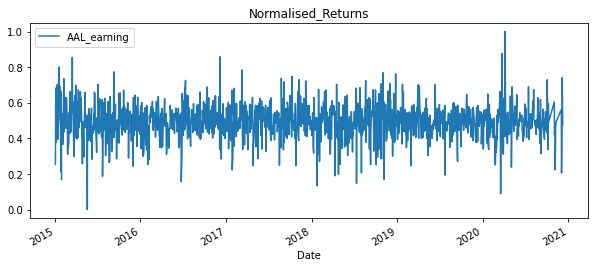

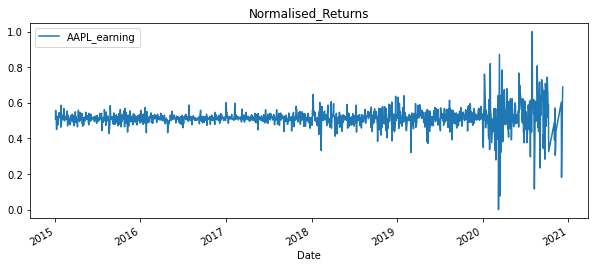

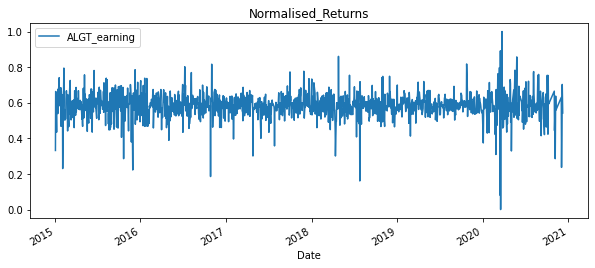

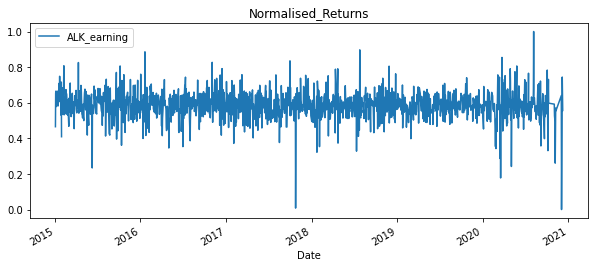

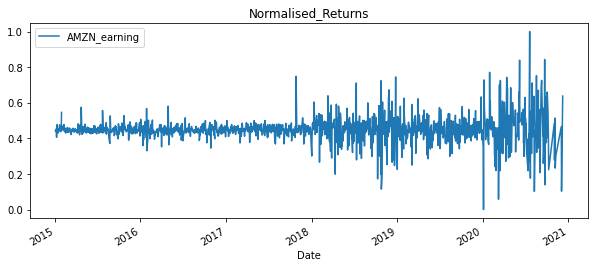

...

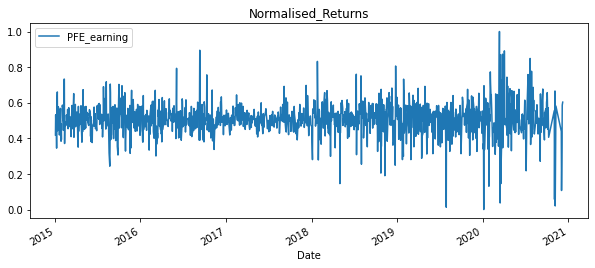

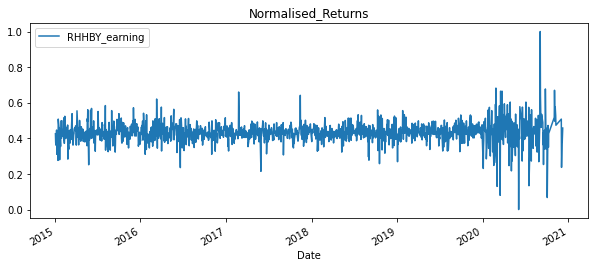

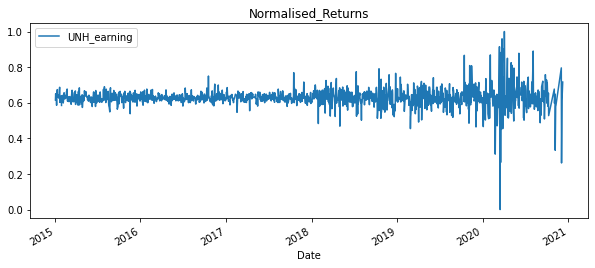

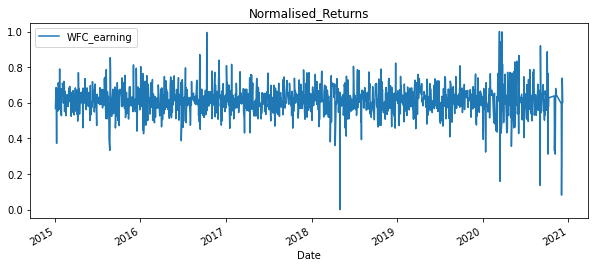

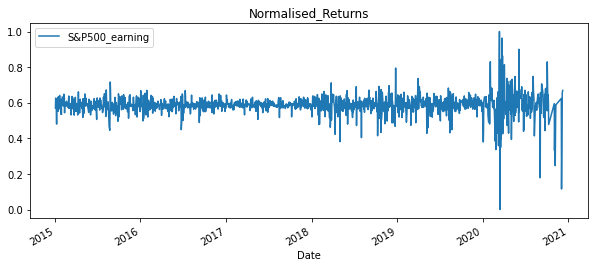

In [185]:
for col in scaled_data.columns:
    scaled_data.plot(title='Normalised_Returns',x='Date',y=col,legend=True, figsize=(10,4))
plt.legend()

# Analysing the Indiviadual Trends

In [21]:
sns.pairplot(proc_data.dropna(),size=7)

# Analysing by sectors 

Aviation Sector

<AxesSubplot:title={'center':'Closing Price'}, xlabel='Date'>

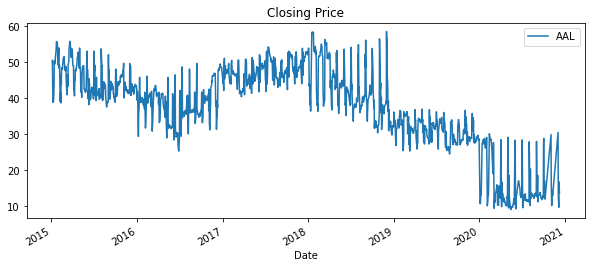

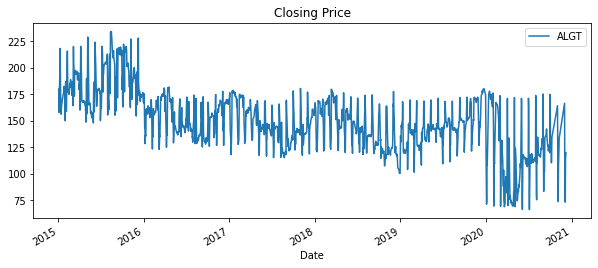

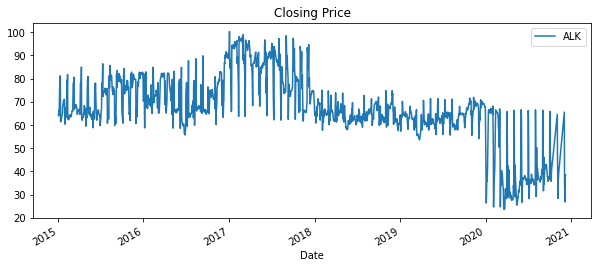

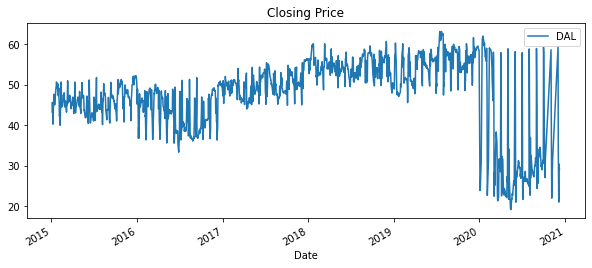

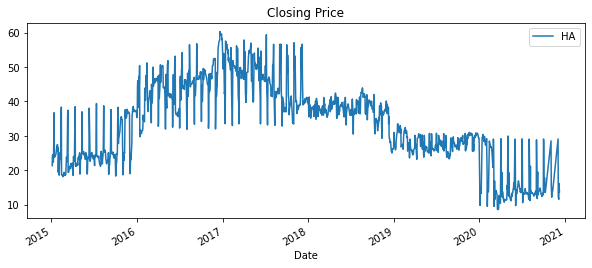

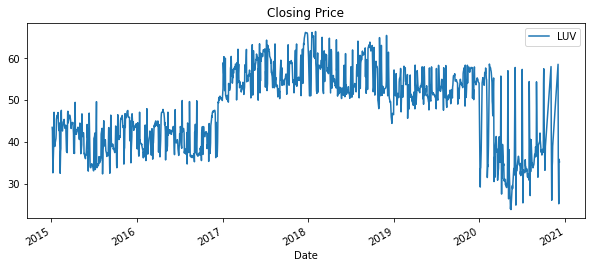

In [26]:
proc_data.plot(title='Closing Price',x='Date',y='AAL',legend=True, figsize=(10,4))
proc_data.plot(title='Closing Price',x='Date',y='ALGT',legend=True, figsize=(10,4))
proc_data.plot(title='Closing Price',x='Date',y='ALK',legend=True, figsize=(10,4))
proc_data.plot(title='Closing Price',x='Date',y='DAL',legend=True, figsize=(10,4))
proc_data.plot(title='Closing Price',x='Date',y='HA',legend=True, figsize=(10,4))
proc_data.plot(title='Closing Price',x='Date',y='LUV',legend=True, figsize=(10,4))

It shows that most of the Aviation industry is in a downward trend and highly volatile stock

# Understanding of Risk Metrics

The reason for finding VaR (Value at Risk ) is to know what potential loss could a investor face in a day based on historical data.  For eg. AAL(American Airlines) has has a VaR of 1.55 which means with 95% confidence we can say that loss will not exceed 15%, based on the confidence interval of 95%, which is very risky.

Lets Assume risk free rate(rf)=2%

Sharpe Ratio= (Return-Risk Free Rate)/ Std. Currently its rf=2% or 0.02

In [239]:
rf=0.02

In [253]:
from tabulate import tabulate

# Calculation of Risk Metrics

In [256]:
for i in df3.columns:
    cum_ret=df3[i].sum()
    std_i=df3[i].std()*np.sqrt(252)
    sharpe_i=(cum_ret-rf)/std_i
    print(tabulate([['Stock','Cumulative Return','Std','Sharpe'],[i,cum_ret,std_i,sharpe_i]]))
    print("\n")
    

-----------  -----------------  ------------------  -------------------
Stock        Cumulative Return  Std                 Sharpe
AAL_earning  -41.62             14.654055809208778  -2.8415341487803634
-----------  -----------------  ------------------  -------------------


------------  -----------------  ------------------  ----------------
Stock         Cumulative Return  Std                 Sharpe
AAPL_earning  88.47749799999998  17.625997423949173  5.01858112607058
------------  -----------------  ------------------  ----------------


------------  -------------------  -----------------  -------------------
Stock         Cumulative Return    Std                Sharpe
ALGT_earning  -30.059998000000007  58.01903399886833  -0.5184505140259095
------------  -------------------  -----------------  -------------------


-----------  -----------------  ------------------  -------------------
Stock        Cumulative Return  Std                 Sharpe
ALK_earning  -23.700001         22.

TypeError: 'DatetimeArray' with dtype datetime64[ns] does not support reduction 'sum'

# VaR for Aviation

In [257]:
df3['AAL_earning'].dropna().quantile(0.05)

-1.5499997499999978

<AxesSubplot:>

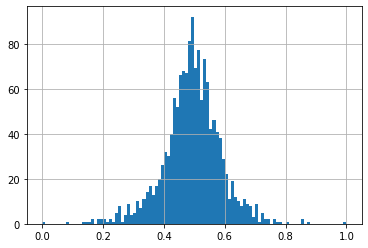

In [258]:
scaled_data['AAL_earning'].hist(bins=100)

In [169]:
df3['ALGT_earning'].dropna().quantile(0.05)

-5.567509000000001

<AxesSubplot:>

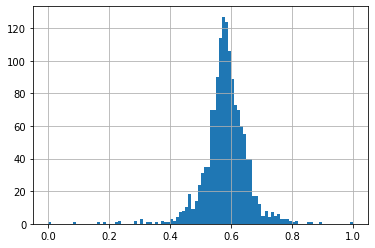

In [259]:
scaled_data['ALGT_earning'].hist(bins=100)

In [260]:
df3['ALK_earning'].dropna().quantile(0.05)

-2.2175005

<AxesSubplot:>

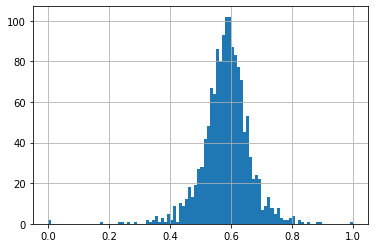

In [261]:
scaled_data['ALK_earning'].hist(bins=100)

In [262]:
df3['DAL_earning'].dropna().quantile(0.05)

-1.5375004999999966

<AxesSubplot:>

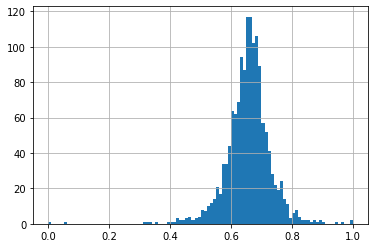

In [263]:
scaled_data['DAL_earning'].hist(bins=100)

In [264]:
df3['HA_earning'].dropna().quantile(0.05)

-1.4650010000000027

<AxesSubplot:>

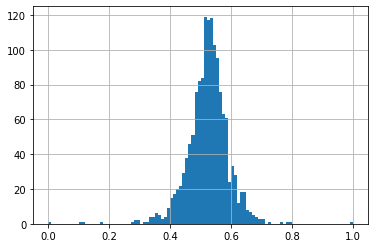

In [265]:
scaled_data['HA_earning'].hist(bins=100)

In [266]:
df3['LUV_earning'].dropna().quantile(0.05)

-1.5175004999999953

<AxesSubplot:>

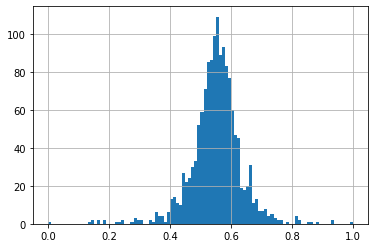

In [267]:
scaled_data['LUV_earning'].hist(bins=100)

# VaR for  Finance

In [212]:
df3['BCS_earning'].dropna().quantile(0.05)

-0.32000149999999894

<AxesSubplot:>

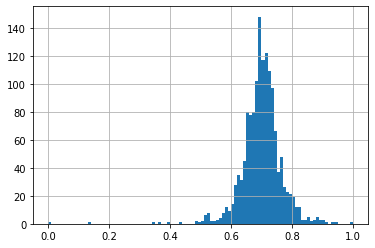

In [167]:
scaled_data['BCS_earning'].hist(bins=100)

In [56]:
df3['CS_earning'].dropna().quantile(0.05)

-0.5400007500000004

<AxesSubplot:>

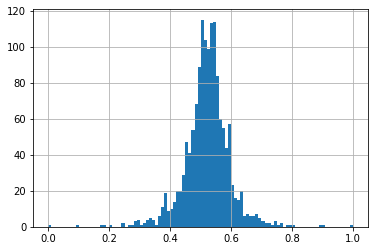

In [211]:
scaled_data['CS_earning'].hist(bins=100)

In [57]:
df3['DB_earning'].dropna().quantile(0.05)

-0.6600000000000001

<AxesSubplot:>

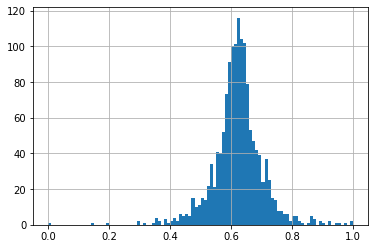

In [210]:
scaled_data['DB_earning'].hist(bins=100)

In [58]:
df3['GS_earning'].dropna().quantile(0.05)

-5.687503999999997

<AxesSubplot:>

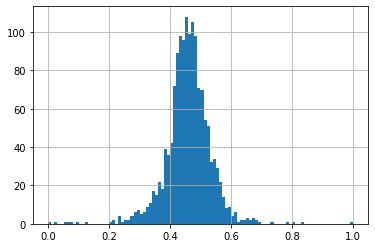

In [209]:
scaled_data['GS_earning'].hist(bins=100)

In [213]:
df3['MS_earning'].dropna().quantile(0.05)

-1.2650007500000005

<AxesSubplot:>

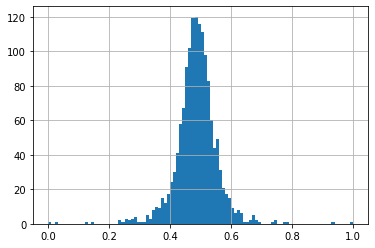

In [207]:
scaled_data['MS_earning'].hist(bins=100)

In [214]:
df3['WFC_earning'].dropna().quantile(0.05)

-1.230003

<AxesSubplot:>

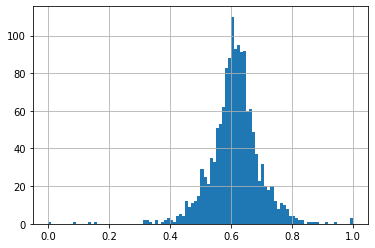

In [205]:
scaled_data['WFC_earning'].hist(bins=100)

# VaR for Healthcare

In [215]:
df3['JNJ_earning'].dropna().quantile(0.05)

-1.9975012499999991

<AxesSubplot:>

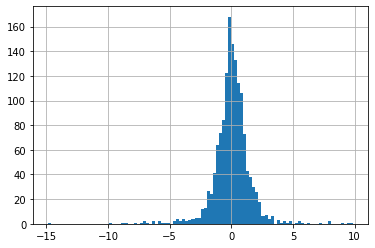

In [100]:
df3['JNJ_earning'].hist(bins=100)

In [63]:
df3['PFE_earning'].dropna().quantile(0.05)

-0.7200000000000024

<AxesSubplot:>

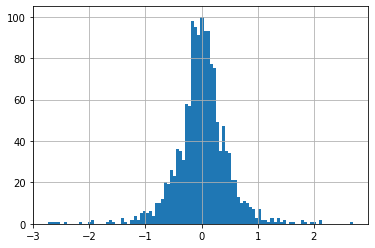

In [99]:
df3['PFE_earning'].hist(bins=100)

In [216]:
df3['UNH_earning'].dropna().quantile(0.05)

-5.262515499999992

<AxesSubplot:>

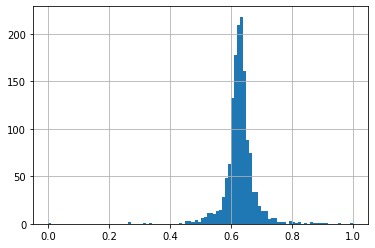

In [202]:
scaled_data['UNH_earning'].hist(bins=100)

In [217]:
df3['BHC_earning'].dropna().quantile(0.05)

-2.9549907500000003

<AxesSubplot:>

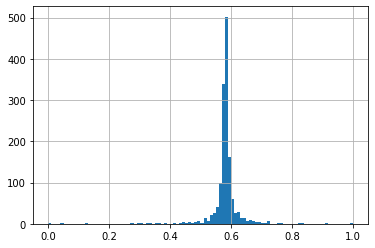

In [200]:
scaled_data['BHC_earning'].hist(bins=100)

In [218]:
df3['RHHBY_earning'].dropna().quantile(0.05)

-0.6900024999999976

<AxesSubplot:>

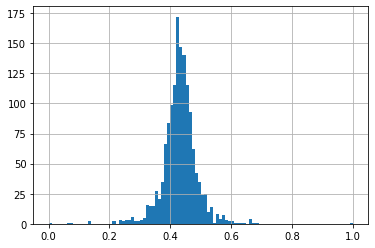

In [198]:
scaled_data['RHHBY_earning'].hist(bins=100)

In [219]:
df3['MRK_earning'].dropna().quantile(0.05)

-1.379997999999997

<AxesSubplot:>

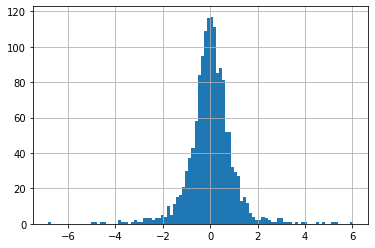

In [95]:
df3['MRK_earning'].hist(bins=100)

# VaR for Tech

In [220]:
df3['AAPL_earning'].dropna().quantile(0.05)

-1.26000025

<AxesSubplot:>

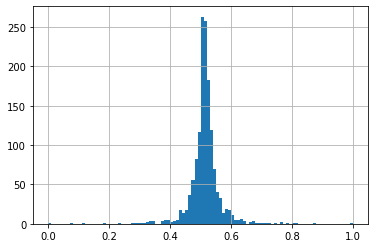

In [195]:
scaled_data['AAPL_earning'].hist(bins=100)

In [221]:
df3['AMZN_earning'].dropna().quantile(0.05)

-43.93002349999995

<AxesSubplot:>

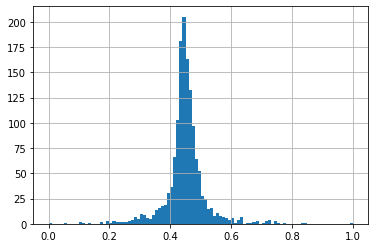

In [193]:
scaled_data['AMZN_earning'].hist(bins=100)

<AxesSubplot:>

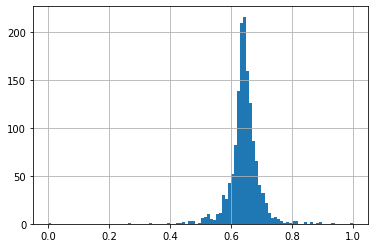

In [223]:
scaled_data['FB_earning'].hist(bins=100)

In [224]:
df3['FB_earning'].dropna().quantile(0.05)

-4.487503000000004

<AxesSubplot:>

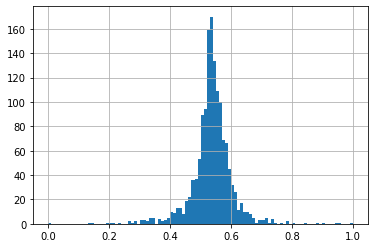

In [187]:
scaled_data['GOOG_earning'].hist(bins=100)

In [225]:
df3['GOOG_earning'].dropna().quantile(0.05)

-27.197509749999995

<AxesSubplot:>

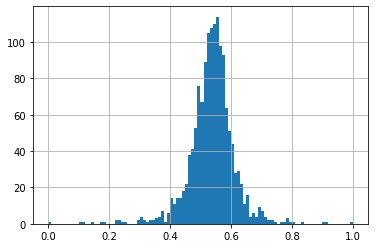

In [189]:
scaled_data['IBM_earning'].hist(bins=100)

In [226]:
df3['IBM_earning'].dropna().quantile(0.05)

-3.2625002500000058

<AxesSubplot:>

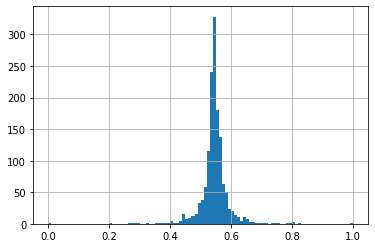

In [228]:
scaled_data['MSFT_earning'].hist(bins=100)

In [229]:
df3['MSFT_earning'].dropna().quantile(0.05)

-2.6750007499999917

# Moving Average considerations

# 100 day moving average

In [77]:
proc_data.set_index("Date")

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,53.910000,27.332500,149.860001,60.330002,308.519989,14.92,144.449997,24.990000,49.180000,30.469999,...,104.519997,42.689999,57.189999,37.500000,46.759998,31.330000,34.279999,100.779999,54.700001,2058.199951
2015-05-01,53.880001,26.562500,148.630005,59.470001,302.190002,14.31,144.289993,24.240000,48.360001,28.820000,...,103.790001,41.639999,58.040001,36.419998,46.330002,31.160000,34.450001,99.120003,53.200001,2020.579956
2015-06-01,53.040001,26.565001,147.839996,58.770000,295.290009,14.00,142.830002,23.809999,47.220001,28.360001,...,103.279999,40.459999,60.320000,36.939999,45.650002,31.420000,34.660000,98.919998,52.090000,2002.609985
2015-07-01,53.009998,26.937500,149.979996,59.669998,298.420013,14.04,145.119995,23.790001,46.970001,28.660000,...,105.559998,40.799999,61.610001,37.490002,46.230000,31.850000,34.810001,99.930000,52.400002,2025.900024
2015-08-01,53.660000,27.972500,155.289993,60.700001,300.459991,14.28,154.100006,23.610001,48.189999,28.719999,...,106.389999,41.880001,62.849998,36.880001,47.590000,32.500000,35.189999,104.699997,53.560001,2062.139893
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,11.770000,108.220001,121.500000,35.700001,3019.790039,4.75,15.220000,9.620000,29.010000,8.110000,...,144.669998,36.860001,83.150002,47.040001,203.190002,35.759998,42.810001,292.660004,23.320000,3246.590088
2020-09-25,12.290000,112.279999,123.760002,36.700001,3095.129883,4.70,15.300000,9.480000,29.780001,8.000000,...,145.660004,37.099998,82.930000,48.380001,207.820007,36.049999,44.820000,302.500000,23.639999,3298.459961
2020-09-28,12.760000,114.959999,127.110001,37.540001,3174.050049,4.99,15.270000,9.900000,31.340000,8.430000,...,147.110001,38.240002,82.760002,47.240002,209.440002,36.389999,44.110001,303.230011,23.820000,3351.600098


In [41]:
# Calculating the long-window simple moving average
long_rolling = proc_data.rolling(window=100).mean()
long_rolling.tail()

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
1442,12.6524,98.325475,112.7136,36.3369,2900.116907,5.5728,17.7053,10.2095,27.8496,9.0494,...,147.0195,34.0525,80.478601,48.1425,201.4012,36.4878,44.1964,302.0433,25.5438,3201.421108
1443,12.6802,98.704375,113.2616,36.4142,2907.890205,5.5695,17.6905,10.2218,27.9303,9.0597,...,146.9811,34.1593,80.527801,48.2533,201.6718,36.4632,44.1988,302.1379,25.5170,3205.721309
1444,12.7153,99.102400,113.8698,36.5113,2916.118105,5.5701,17.6720,10.2395,28.0337,9.0760,...,146.9714,34.2924,80.584201,48.3376,201.9408,36.4420,44.1947,302.2825,25.4991,3210.753110
1445,12.7424,99.483950,114.4184,36.5955,2923.890803,5.5685,17.6621,10.2548,28.1230,9.0888,...,146.9661,34.4140,80.647201,48.4203,202.1774,36.4341,44.1798,302.4740,25.4794,3215.295911
1446,12.7639,99.866725,114.8623,36.6618,2931.582002,5.5659,17.6494,10.2704,28.2016,9.1015,...,146.9679,34.5170,80.712700,48.5055,202.4339,36.4289,44.1571,302.7217,25.4602,3219.627910


In [50]:
long_rolling.set_index('Date')

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,12.6524,98.325475,112.7136,36.3369,2900.116907,5.5728,17.7053,10.2095,27.8496,9.0494,...,147.0195,34.0525,80.478601,48.1425,201.4012,36.4878,44.1964,302.0433,25.5438,3201.421108
2020-09-25,12.6802,98.704375,113.2616,36.4142,2907.890205,5.5695,17.6905,10.2218,27.9303,9.0597,...,146.9811,34.1593,80.527801,48.2533,201.6718,36.4632,44.1988,302.1379,25.5170,3205.721309
2020-09-28,12.7153,99.102400,113.8698,36.5113,2916.118105,5.5701,17.6720,10.2395,28.0337,9.0760,...,146.9714,34.2924,80.584201,48.3376,201.9408,36.4420,44.1947,302.2825,25.4991,3210.753110


KeyError: 'Date'

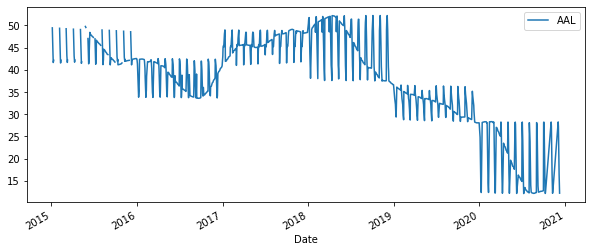

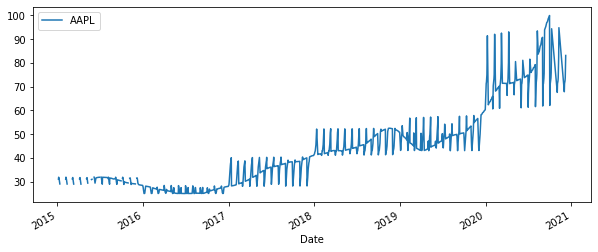

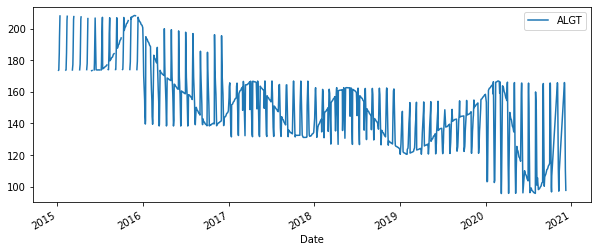

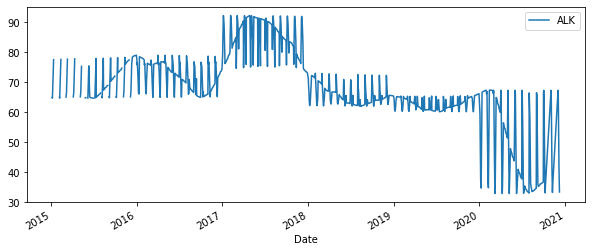

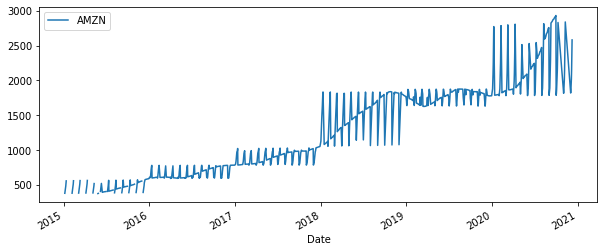

...

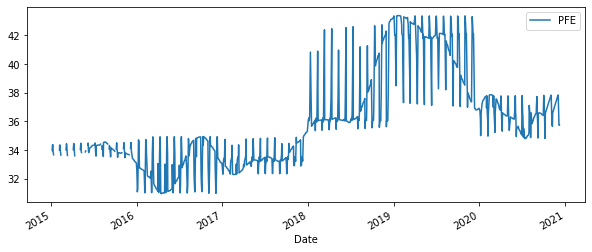

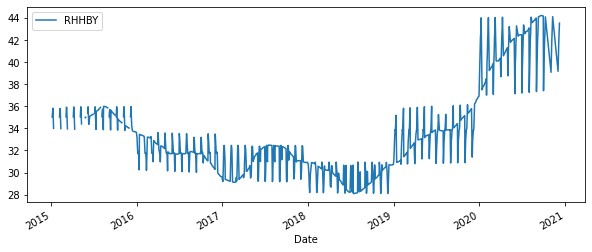

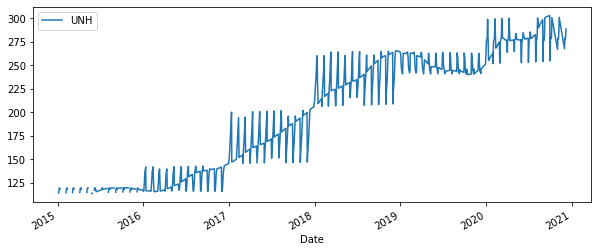

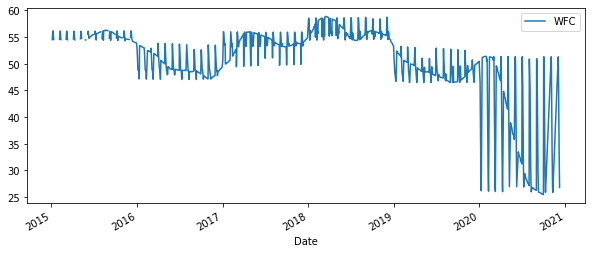

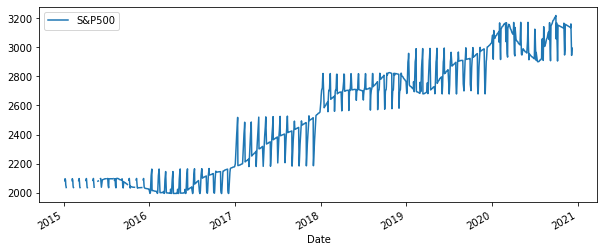

In [51]:
for col in long_rolling.columns:
    long_rolling.plot(x='Date',y=col,figsize=(10,4))
plt.legend()

# short rolling for a 20 day period

In [54]:
short_rolling=proc_data.rolling(window=20).mean()
short_rolling.tail(20)

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
1427,13.1075,120.010499,122.066500,37.7205,3290.458496,5.6740,17.2615,11.1475,29.1775,9.5140,...,150.629501,35.715000,84.134501,51.875499,215.878500,38.1485,43.8510,315.747998,24.5000,3420.225513
1428,13.1235,120.359374,122.748000,37.9190,3297.608496,5.6730,17.0535,11.1450,29.3845,9.5175,...,150.729501,36.001000,84.356500,51.993499,215.926000,38.0550,43.9100,315.856499,24.5140,3425.520520
1429,13.1525,120.851749,123.522500,38.1295,3303.966504,5.6800,16.9655,11.1405,29.6140,9.5430,...,150.729000,36.306500,84.567500,51.972999,216.014500,37.9505,44.0115,315.604999,24.5000,3429.304517
1430,13.1340,120.856374,124.287999,38.2470,3304.050513,5.6690,16.8860,11.1050,29.7740,9.5425,...,150.690500,36.582000,84.688500,51.936999,215.735001,37.8275,44.1435,315.012498,24.4635,3427.873022
1431,13.1000,121.253624,124.882499,38.3315,3313.447522,5.6510,16.8110,11.0785,29.8800,9.5355,...,150.827000,36.778500,84.887000,51.832499,216.130500,37.7470,44.2785,314.835999,24.3895,3431.136523
1432,13.0735,121.277624,125.604000,38.4530,3314.091028,5.6290,16.7240,11.0355,30.0150,9.5175,...,150.689500,36.963000,84.931500,51.740999,215.939500,37.6130,44.4010,313.952499,24.3275,3429.078516
1433,13.0560,121.127124,126.355000,38.5800,3311.851025,5.6105,16.6345,11.0030,30.1650,9.5030,...,150.678500,37.175000,84.978500,51.683499,215.706000,37.5080,44.5280,312.950500,24.2900,3427.455518
1434,13.0525,121.149749,127.256000,38.7715,3309.598523,5.5925,16.5560,10.9935,30.3585,9.4940,...,150.684000,37.433000,85.012500,51.638999,215.531500,37.4555,44.6455,312.194000,24.2655,3427.990015
1435,13.0785,121.196374,128.360500,39.0675,3308.284521,5.5730,16.4755,10.9755,30.6330,9.4760,...,150.678999,37.773000,84.985000,51.650500,215.456500,37.3860,44.7665,311.530000,24.2860,3428.950513
1436,13.1385,121.024749,129.617000,39.4140,3296.565027,5.5550,16.4530,10.9720,30.9800,9.4705,...,150.594499,38.170000,85.035500,51.594500,215.134500,37.3070,44.8850,311.015500,24.3695,3428.736011


In [55]:
Date=proc_data['Date']
short_rolling=short_rolling.join(Date)
short_rolling.set_index('Date')

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,13.0565,116.967374,132.281500,40.0290,3203.284021,5.3000,16.2925,10.6895,31.6300,9.1640,...,148.779000,38.9955,84.6165,50.3695,211.5560,36.6230,44.9505,306.940501,24.3435,3391.009509
2020-09-25,13.0070,116.330874,131.892000,39.9390,3188.040515,5.2460,16.2075,10.6065,31.5780,9.0775,...,148.413001,38.9680,84.4720,50.1440,210.6180,36.5325,44.9350,306.482001,24.2960,3381.705005
2020-09-28,12.9655,115.838498,131.598000,39.7795,3176.653015,5.1980,16.1255,10.5415,31.5455,9.0045,...,148.086501,38.9395,84.3275,49.8930,209.6445,36.4565,44.9500,305.925002,24.2525,3373.884509


KeyError: 'Date'

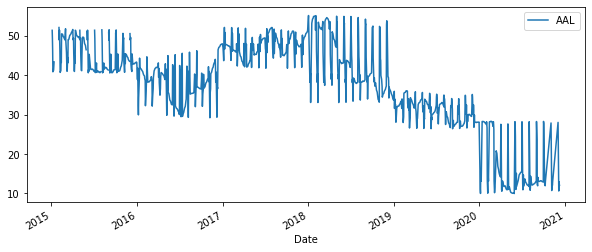

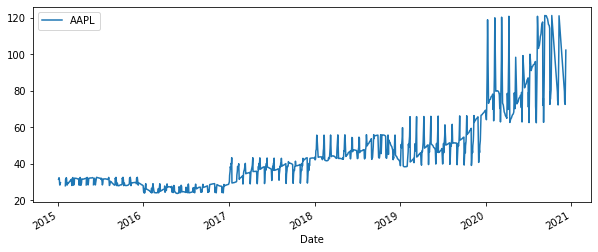

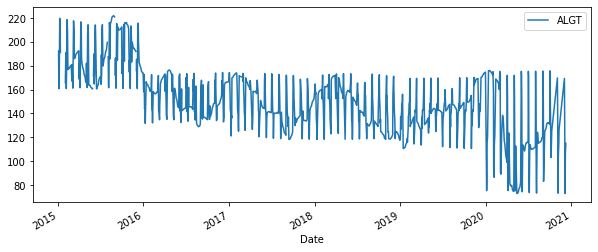

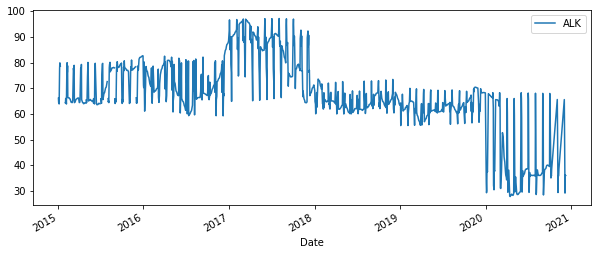

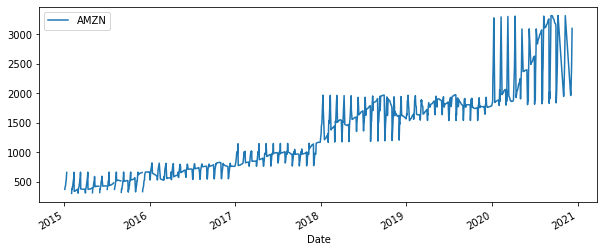

...

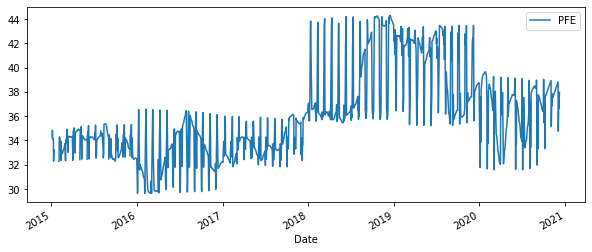

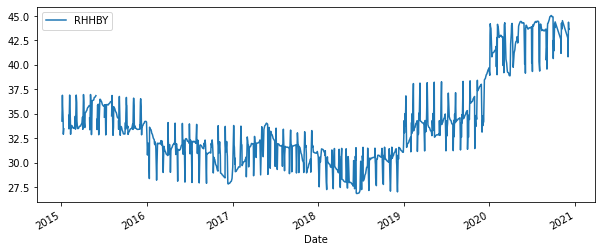

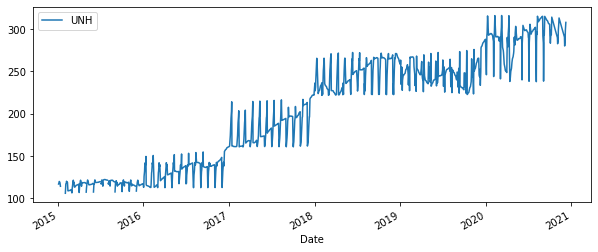

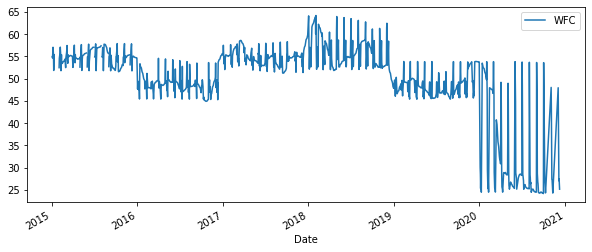

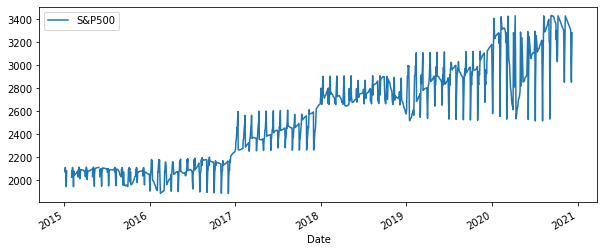

In [56]:
for col in short_rolling.columns:
    short_rolling.plot(x='Date',y=col,figsize=(10,4))
plt.legend()

# Fifty Day Rolling Average

In [73]:
fifty_day=proc_data.rolling(window=50).mean()
fifty_day.tail(20)

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
1427,12.4538,105.652200,115.6498,36.4830,3121.414800,5.6872,17.8168,10.7716,27.6996,9.5654,...,147.3612,34.0222,80.798201,50.5572,210.2514,36.7350,43.9958,306.539399,24.9650,3283.953813
1428,12.4602,106.269499,116.1248,36.6030,3134.086802,5.6876,17.7650,10.7926,27.7772,9.5688,...,147.5558,34.1520,80.990600,50.6356,210.6406,36.8192,44.0192,307.080399,24.9330,3292.048413
1429,12.4690,106.864499,116.6588,36.7098,3144.887603,5.6882,17.7110,10.8058,27.8524,9.5720,...,147.7342,34.2804,81.164000,50.6980,210.9188,36.9000,44.0434,307.395999,24.8814,3298.912412
1430,12.4940,107.352749,117.2156,36.8558,3154.027002,5.6878,17.6696,10.8150,27.9650,9.5802,...,147.9232,34.4512,81.326800,50.7744,211.0454,36.9778,44.0714,307.803399,24.8540,3305.368213
1431,12.4886,107.890249,117.6598,36.9310,3165.791606,5.6834,17.6290,10.8272,28.0280,9.5794,...,148.1364,34.5348,81.502000,50.8142,211.3024,37.0486,44.1144,308.248599,24.8168,3312.282612
1432,12.4874,108.336049,118.1620,37.0236,3174.117407,5.6762,17.5762,10.8350,28.1028,9.5760,...,148.2620,34.6300,81.626800,50.8690,211.3396,37.1076,44.1624,308.441599,24.7838,3317.060610
1433,12.4902,108.755500,118.6578,37.1162,3178.867808,5.6688,17.5158,10.8468,28.1828,9.5748,...,148.4100,34.7328,81.754000,50.9362,211.3262,37.1542,44.2072,308.516599,24.7674,3321.562808
1434,12.5054,109.242150,119.2018,37.2166,3183.121206,5.6586,17.4672,10.8644,28.2848,9.5710,...,148.5576,34.8516,81.861600,50.9676,211.3092,37.2042,44.2540,308.722798,24.7568,3326.633408
1435,12.5122,109.683700,119.7448,37.3186,3185.103003,5.6464,17.4124,10.8700,28.3862,9.5540,...,148.6758,34.9778,81.954200,51.0408,211.2708,37.2532,44.2954,308.811199,24.7446,3331.063008
1436,12.5500,110.062850,120.4528,37.4590,3186.662603,5.6392,17.3814,10.8834,28.5374,9.5434,...,148.7868,35.1596,82.091200,51.0676,211.2068,37.3082,44.3378,309.008599,24.7696,3335.866406


In [81]:
fifty_day.set_index('Date')

,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC,S&P500
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-05-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,12.6164,111.605549,122.6604,37.7732,3174.905400,5.5126,17.2362,10.8370,29.0200,9.3676,...,148.8918,35.7788,82.8296,50.7500,210.2620,37.5138,44.2252,308.9726,24.6698,3349.272207
2020-09-25,12.6132,111.920699,122.8202,37.7616,3176.810000,5.4886,17.1760,10.8134,29.0704,9.3268,...,148.8200,35.8366,82.9002,50.6694,210.3400,37.5228,44.1926,308.8796,24.6334,3350.930005
2020-09-28,12.6302,112.293349,123.0956,37.7724,3181.051602,5.4728,17.1202,10.7986,29.1562,9.2960,...,148.7752,35.9188,82.9580,50.5770,210.4712,37.5256,44.1942,308.8136,24.6108,3353.467407


KeyError: 'Date'

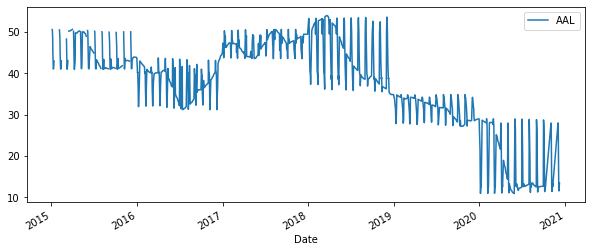

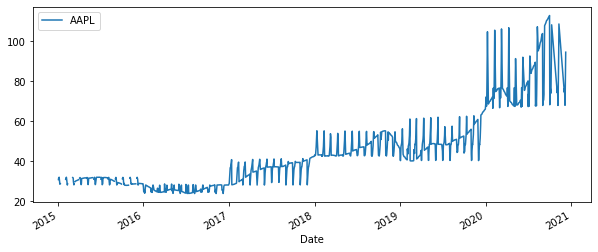

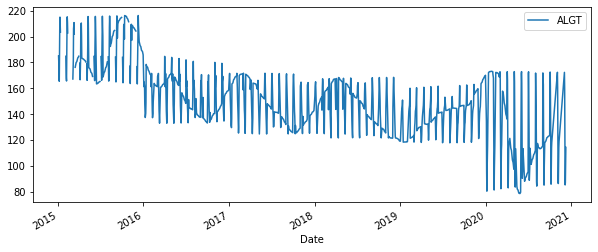

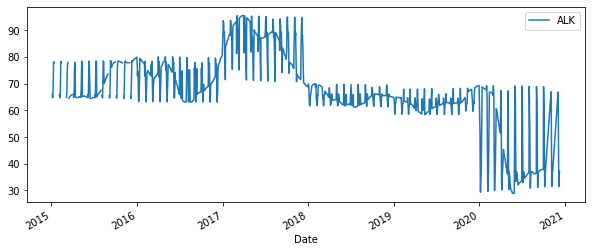

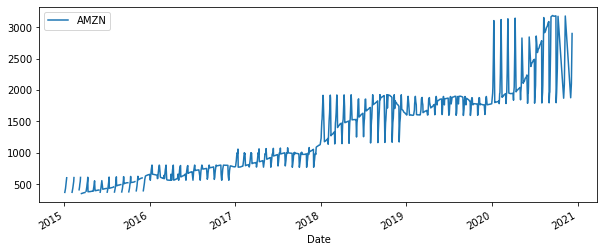

...

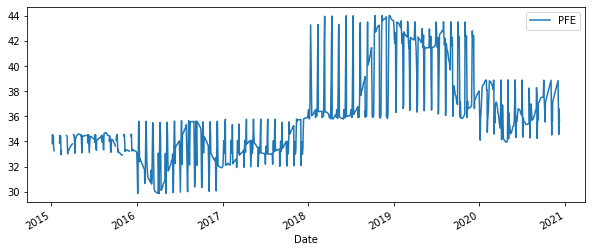

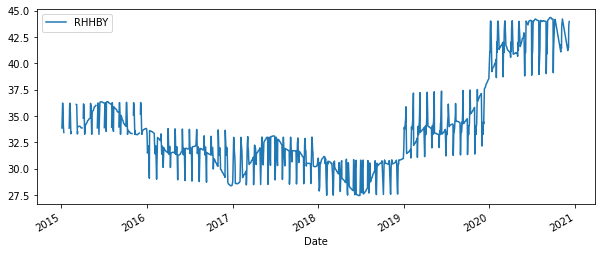

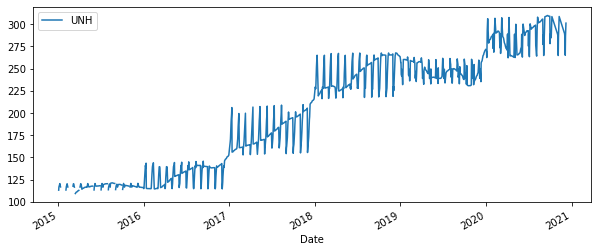

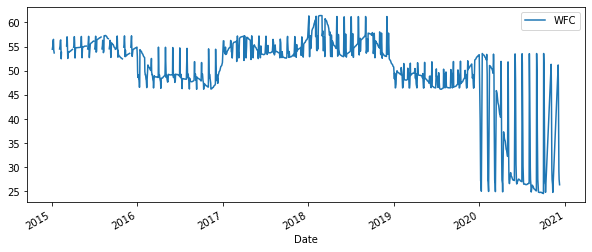

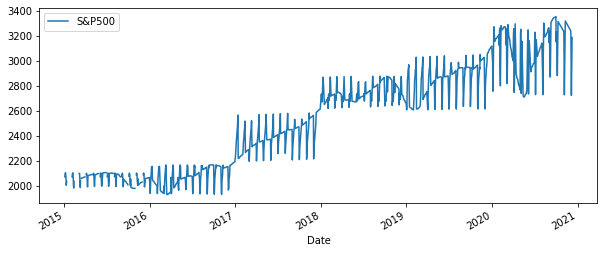

In [82]:
for col in fifty_day.columns:
    fifty_day.plot(x='Date',y=col,figsize=(10,4))
plt.legend()

# Conclusion

As per the metrics
The following stocks are considered to be good stocks which have performed well : AAPL,AMZN,FB,JNJ,MRK,MS,MSFT,UNH


The following stocks are risky: AAL,ALGT,DAL,DB,IBM,WFC